Import the packages needed

In [1]:
# Import the packages 
from ipfx.feature_extractor import (SpikeFeatureExtractor,
                                    SpikeTrainFeatureExtractor)
import pyabf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os 
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

Check your current directory.

In [2]:
current_directory = os.getcwd()
print("Current Directory:", current_directory)

Current Directory: C:\Users\nesia\python\ephys\basic_programs


Make sure you folder/directory is in the current directory. Then run the program which calculates the number APs in each sweep. 

The parameters in this program was designed for human DRG. Though it does a good job ~90% of the time, it may overestimate the number APs is some files where the membrane volatge stays above 10mV during the 500ms current input. Check your output file for high AP numbers at the end of each column in the dataframe and use another method to count APs for those ABF files. Setting parameters that work for all files has not been possible because human DRG neurons have a wide variety AP wavefrom properties, hence the issues with perfect AP counting on every file. Changing the parameters dv_cutoff, thresh_fract, max_interval, and min_peak may help though I have played around with them and this is the best I could come up with to do well on the majority of files in one go of the files. 

In [3]:
# Directory containing ABF files
directory = "HS21"

# List to store DataFrame for each file
avg_rate_dataframes = []

# Iterate over each file in the directory
for file in os.listdir(directory):
    if file.endswith(".abf"):
        abf = pyabf.ABF(os.path.join(directory, file))
        
        # Set the dataframe for the table
        table = pd.DataFrame()

        # Loop function to analyze each voltage and current trace of the file
        for sweep in abf.sweepList:
            abf.setSweep(sweep)
            time = abf.sweepX
            voltage = abf.sweepY
            current = abf.sweepC

            currents = [] # Current value between t1 and t2 (ms) for each step
            t1 = int(400*abf.dataPointsPerMs)
            t2 = int(500*abf.dataPointsPerMs)
            current_mean = np.average(abf.sweepC[t1:t2])

            start, end = 0.025, 0.525
            sfx = SpikeFeatureExtractor(start, end, filter=None, dv_cutoff=2.0, thresh_frac=0.5, max_interval=0.02, min_peak=10)
            sfx_results = sfx.process(time, voltage, current)
            stfx = SpikeTrainFeatureExtractor(start=start, end=end)
            stfx_results = stfx.process(time, voltage, current, sfx_results)

            # Create a table with the stfx results
            length = len(table)
            table.loc[length, 'current_step'] = current_mean
            table.loc[length, 'avg_rate'] = stfx_results["avg_rate"] * (end - start)

        # Append DataFrame for current file to the list
        avg_rate_dataframes.append(table[['avg_rate']])

# Concatenate DataFrames for all files into a single DataFrame
all_avg_rate_data = pd.concat(avg_rate_dataframes, axis=1)

# Rename columns with ABF filenames
all_avg_rate_data.columns = [file for file in os.listdir(directory) if file.endswith(".abf")]

# Show the DataFrame
print(all_avg_rate_data)

     HS21_009_0000.abf  HS21_010_0000.abf  HS21_011_0000.abf  \
0                  0.0                0.0                0.0   
1                  0.0                0.0                0.0   
2                  0.0                0.0                0.0   
3                  0.0                0.0                0.0   
4                  0.0                0.0                0.0   
..                 ...                ...                ...   
395                NaN                NaN                NaN   
396                NaN                NaN                NaN   
397                NaN                NaN                NaN   
398                NaN                NaN                NaN   
399                NaN                NaN                NaN   

     HS21_012_0000.abf  HS21_013_0000.abf  HS21_014_0000.abf  \
0                  0.0                0.0                0.0   
1                  0.0                0.0                0.0   
2                  0.0                0

Save as CSV file. 

In [4]:
file_name = "HS21_fI2.csv"
all_avg_rate_data.to_csv(file_name, index=False)

Check AP count plots for each file. This can help ID traces that over counted the number of APs

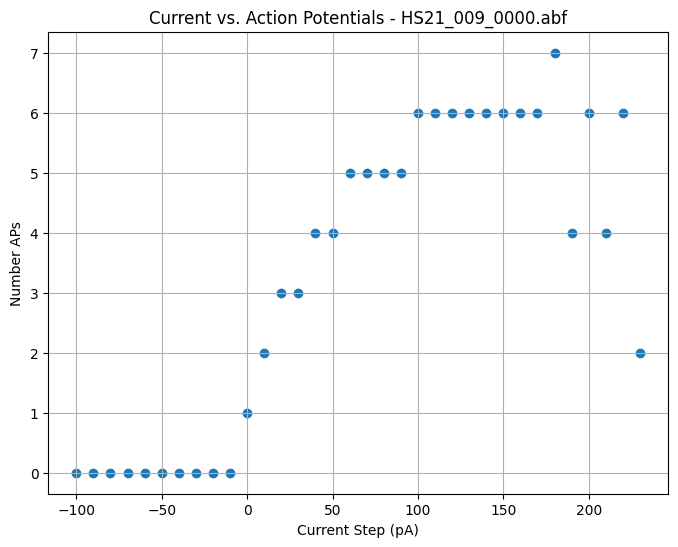

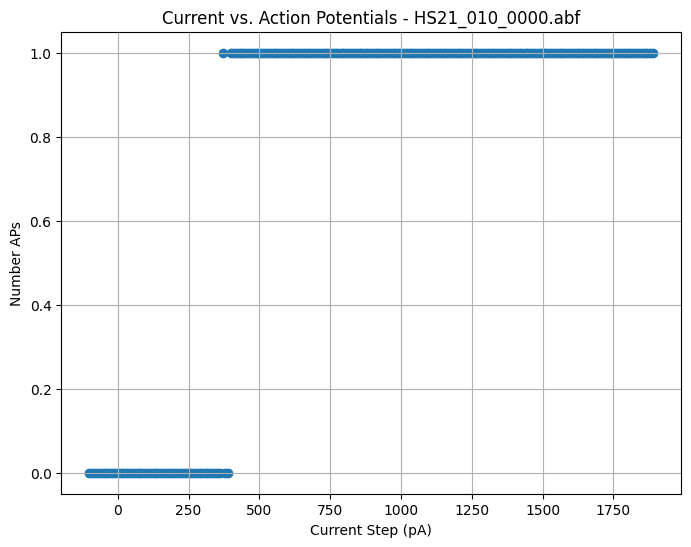

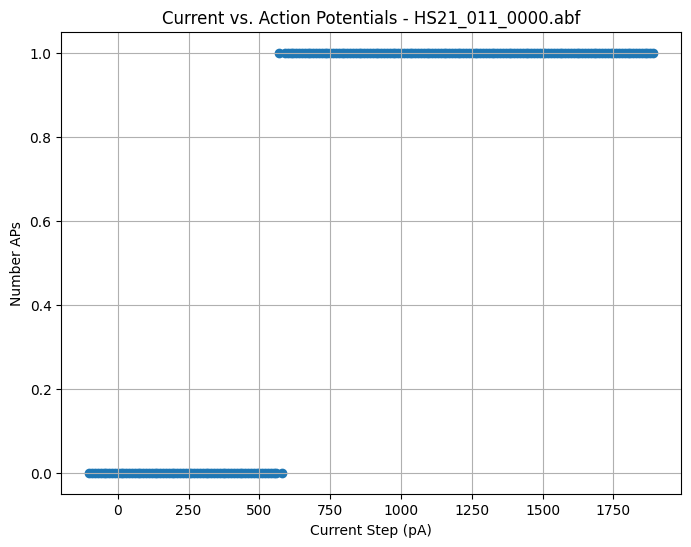

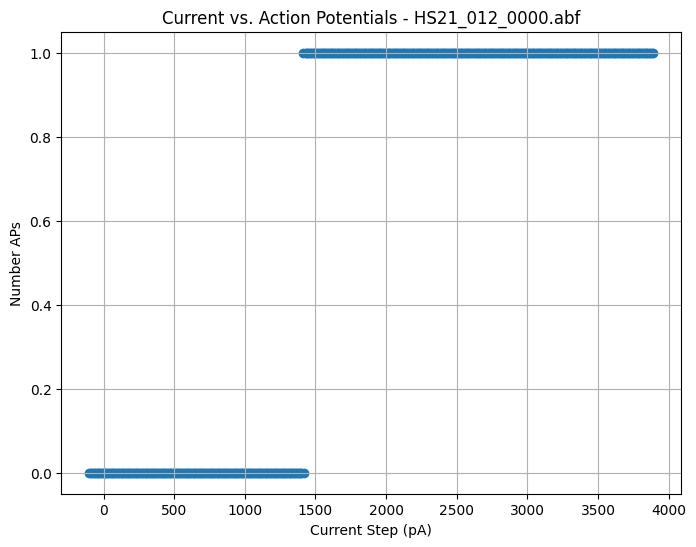

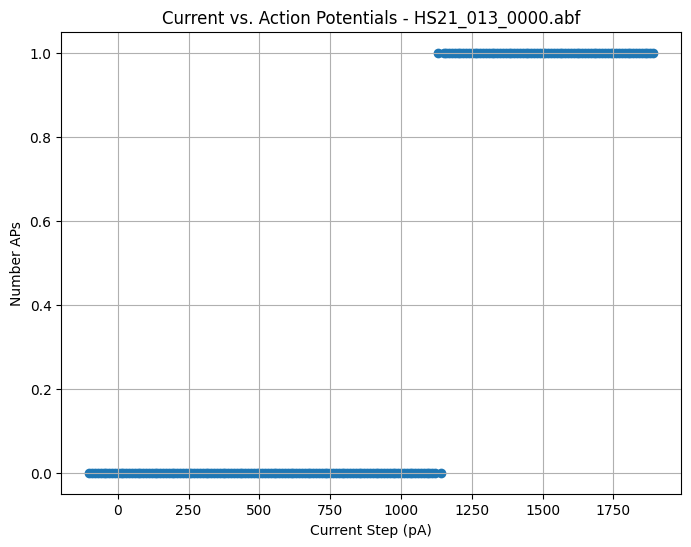

...

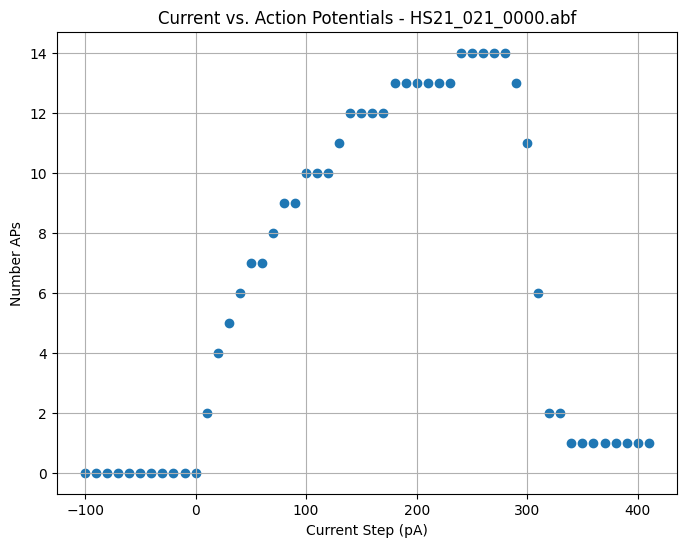

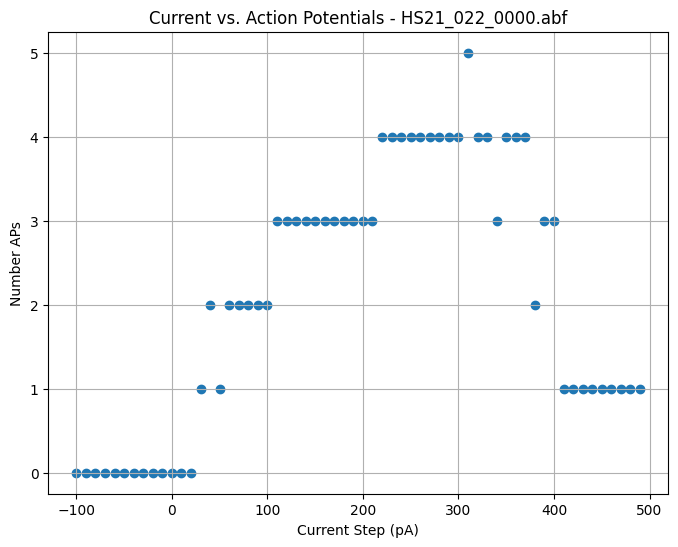

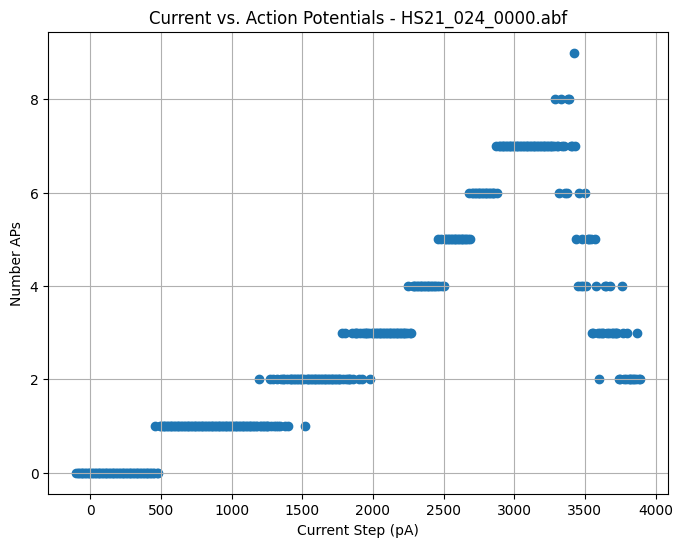

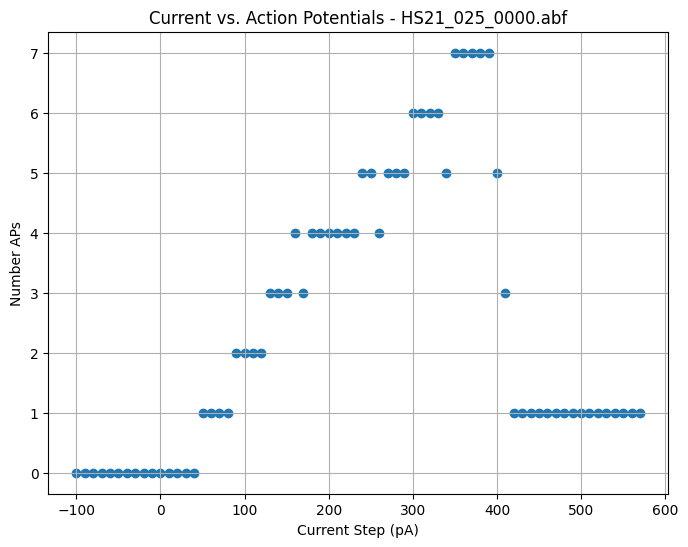

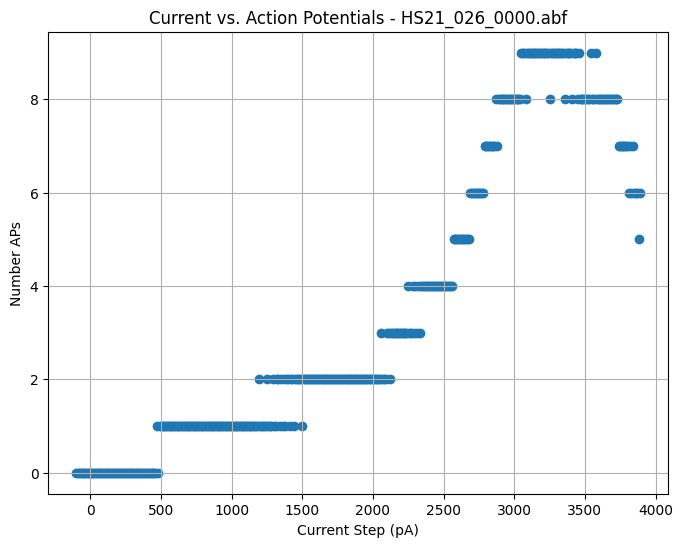

In [5]:
# Plot current vs. average rate for each file
for column in all_avg_rate_data.columns:
    plt.figure(figsize=(8, 6))
    # Generate current step values starting from -100pA increasing by 10 for each step
    current_steps = np.arange(-100, -100 + 10 * len(all_avg_rate_data), 10)
    plt.scatter(current_steps, all_avg_rate_data[column], label=column)
    plt.xlabel('Current Step (pA)')
    plt.ylabel('Number APs')
    plt.title(f'Current vs. Action Potentials - {column}')
    plt.grid(True)
    plt.show()

If there are files that are not counting APs faithfully you can each file indivdually. Load the ABF file you are concerned about. 

There are multiple ways to view each ABF so you can see the APs while you tune the parameters for that file. The first way is to plot all the sweeps. For ABF 

Another way is to make a video of the ABF file sweep by sweep. For files with a lot of sweeps, I find the video method much easier.

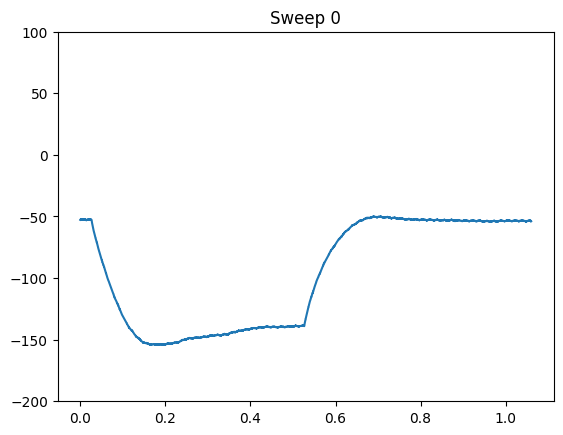

In [6]:
# Load the ABF file
abf = pyabf.ABF("HS21/HS21_016_0000.abf")

# Initialize the plot
fig, ax = plt.subplots()

# Function to update the plot for each frame
def update(frame):
    ax.clear()
    abf.setSweep(frame)
    ax.plot(abf.sweepX, abf.sweepY)
    ax.set_title(f"Sweep {frame}")
    ax.set_ylim(-200, 100)  # Set y-axis limits

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=abf.sweepCount, interval=100)

# Display the animation inline in the notebook
HTML(ani.to_jshtml())


Adjust the parameters so this file faithfully counts APs for this abf file

Number of sweeps: 138
    current_step avg_rate
0         -100.0      0.0
1          -90.0      0.0
2          -80.0      0.0
3          -70.0      0.0
4          -60.0      0.0
..           ...      ...
133       1230.0      1.0
134       1240.0      1.0
135       1250.0      1.0
136       1260.0      1.0
137       1270.0      1.0

[138 rows x 2 columns]


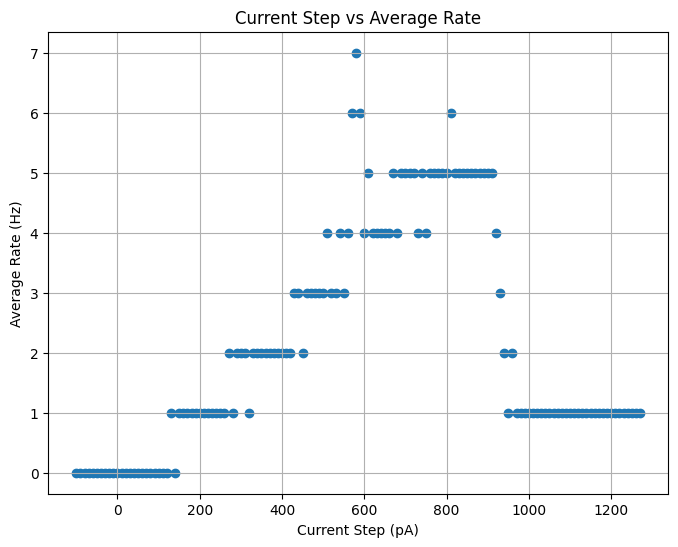

In [7]:
# Set the file path
data = 'HS21/HS21_016_0000.abf'
abf = pyabf.ABF(data)

# Initialize an empty DataFrame to store the results
table = pd.DataFrame(columns=['current_step', 'avg_rate'])

# Check the number of sweeps in the ABF file
num_sweeps = abf.sweepCount
print("Number of sweeps:", num_sweeps)

# Loop function to analyze each voltage and current trace of the file
for sweep in range(num_sweeps):
    abf.setSweep(sweep)
    time = abf.sweepX
    voltage = abf.sweepY
    current = abf.sweepC

    currents = [] # Current value between t1 and t2 (ms) for each step
    t1 = int(400*abf.dataPointsPerMs)
    t2 = int(500*abf.dataPointsPerMs)
    current_mean = np.average(abf.sweepC[t1:t2])

    start, end = 0.025, 0.525
    sfx = SpikeFeatureExtractor(start, end, filter=None, dv_cutoff=10.0, thresh_frac=0.5, max_interval=0.01, min_peak=40)
    sfx_results = sfx.process(time, voltage, current)
    stfx = SpikeTrainFeatureExtractor(start=start, end=end)
    stfx_results = stfx.process(time, voltage, current, sfx_results)

    # Update the table with the stfx results
    table.loc[sweep, 'current_step'] = current_mean
    table.loc[sweep, 'avg_rate'] = stfx_results["avg_rate"] * (end - start)

print(table)

# Plot current_step vs avg_rate
plt.figure(figsize=(8, 6))
plt.scatter(table['current_step'], table['avg_rate'], marker='o')
plt.xlabel('Current Step (pA)')
plt.ylabel('Average Rate (Hz)')
plt.title('Current Step vs Average Rate')
plt.grid(True)
plt.show()

Replace the data from the column HS21_016_0000.abf in the all_avg_rate_data dataframe with the corrected data. Repeat as necessary for all columns where a mistake has been made. 

In [8]:
# Assuming all_avg_rate_data is already defined and contains the columns with ABF filenames

# Extract the column name
column_name = 'HS21_016_0000.abf'

# Replace the data in the column with the new data from the table DataFrame
all_avg_rate_data[column_name] = table['avg_rate']

print(all_avg_rate_data)


     HS21_009_0000.abf  HS21_010_0000.abf  HS21_011_0000.abf  \
0                  0.0                0.0                0.0   
1                  0.0                0.0                0.0   
2                  0.0                0.0                0.0   
3                  0.0                0.0                0.0   
4                  0.0                0.0                0.0   
..                 ...                ...                ...   
395                NaN                NaN                NaN   
396                NaN                NaN                NaN   
397                NaN                NaN                NaN   
398                NaN                NaN                NaN   
399                NaN                NaN                NaN   

     HS21_012_0000.abf  HS21_013_0000.abf  HS21_014_0000.abf  \
0                  0.0                0.0                0.0   
1                  0.0                0.0                0.0   
2                  0.0                0

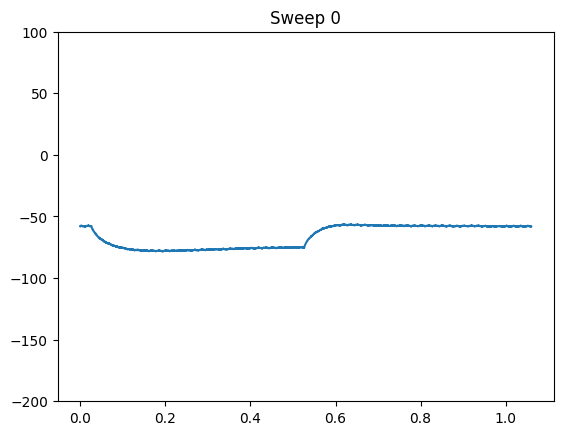

In [72]:
# Load the ABF file
abf = pyabf.ABF("HS21/HS21_017_0000.abf")

# Initialize the plot
fig, ax = plt.subplots()

# Function to update the plot for each frame
def update(frame):
    ax.clear()
    abf.setSweep(frame)
    ax.plot(abf.sweepX, abf.sweepY)
    ax.set_title(f"Sweep {frame}")
    ax.set_ylim(-200, 100)  # Set y-axis limits

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=abf.sweepCount, interval=100)

# Display the animation inline in the notebook
HTML(ani.to_jshtml())


Number of sweeps: 298
    current_step avg_rate
0         -100.0      0.0
1          -90.0      0.0
2          -80.0      0.0
3          -70.0      0.0
4          -60.0      0.0
..           ...      ...
293       2830.0      1.0
294       2840.0      1.0
295       2850.0      1.0
296       2860.0      1.0
297       2870.0      1.0

[298 rows x 2 columns]


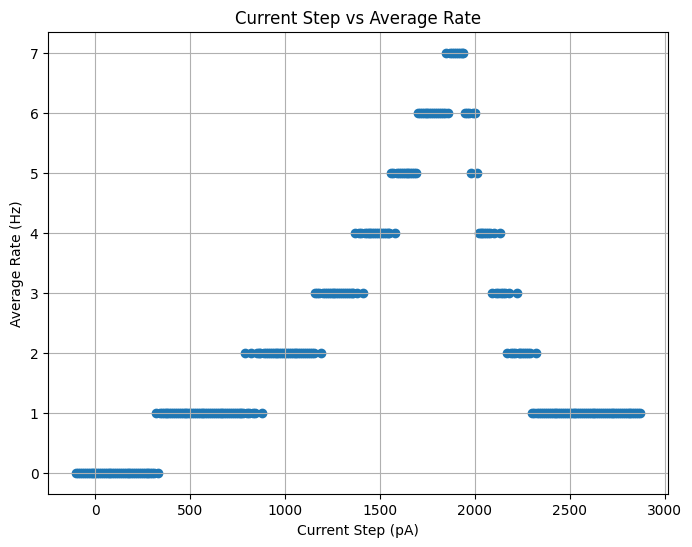

In [9]:
# Set the file path
data = 'HS21/HS21_017_0000.abf'
abf = pyabf.ABF(data)

# Initialize an empty DataFrame to store the results
table = pd.DataFrame(columns=['current_step', 'avg_rate'])

# Check the number of sweeps in the ABF file
num_sweeps = abf.sweepCount
print("Number of sweeps:", num_sweeps)

# Loop function to analyze each voltage and current trace of the file
for sweep in range(num_sweeps):
    abf.setSweep(sweep)
    time = abf.sweepX
    voltage = abf.sweepY
    current = abf.sweepC

    currents = [] # Current value between t1 and t2 (ms) for each step
    t1 = int(400*abf.dataPointsPerMs)
    t2 = int(500*abf.dataPointsPerMs)
    current_mean = np.average(abf.sweepC[t1:t2])

    start, end = 0.025, 0.525
    sfx = SpikeFeatureExtractor(start, end, filter=None, dv_cutoff=20.0, thresh_frac=0.5, max_interval=0.01, min_peak=10)
    sfx_results = sfx.process(time, voltage, current)
    stfx = SpikeTrainFeatureExtractor(start=start, end=end)
    stfx_results = stfx.process(time, voltage, current, sfx_results)

    # Update the table with the stfx results
    table.loc[sweep, 'current_step'] = current_mean
    table.loc[sweep, 'avg_rate'] = stfx_results["avg_rate"] * (end - start)

print(table)

# Plot current_step vs avg_rate
plt.figure(figsize=(8, 6))
plt.scatter(table['current_step'], table['avg_rate'], marker='o')
plt.xlabel('Current Step (pA)')
plt.ylabel('Average Rate (Hz)')
plt.title('Current Step vs Average Rate')
plt.grid(True)
plt.show()

In [47]:
# Assuming all_avg_rate_data is already defined and contains the columns with ABF filenames

# Extract the column name
column_name = 'HS21_017_0000.abf'

# Replace the data in the column with the new data from the table DataFrame
all_avg_rate_data[column_name] = table['avg_rate']

print(all_avg_rate_data)


     HS21_009_0000.abf  HS21_010_0000.abf  HS21_011_0000.abf  \
0                  0.0                0.0                0.0   
1                  0.0                0.0                0.0   
2                  0.0                0.0                0.0   
3                  0.0                0.0                0.0   
4                  0.0                0.0                0.0   
..                 ...                ...                ...   
395                NaN                NaN                NaN   
396                NaN                NaN                NaN   
397                NaN                NaN                NaN   
398                NaN                NaN                NaN   
399                NaN                NaN                NaN   

     HS21_012_0000.abf  HS21_013_0000.abf  HS21_014_0000.abf  \
0                  0.0                0.0                0.0   
1                  0.0                0.0                0.0   
2                  0.0                0

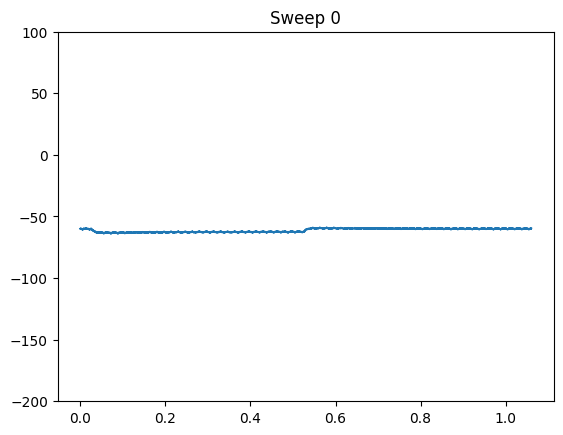

In [73]:
# Load the ABF file
abf = pyabf.ABF("HS21/HS21_014_0000.abf")

# Initialize the plot
fig, ax = plt.subplots()

# Function to update the plot for each frame
def update(frame):
    ax.clear()
    abf.setSweep(frame)
    ax.plot(abf.sweepX, abf.sweepY)
    ax.set_title(f"Sweep {frame}")
    ax.set_ylim(-200, 100)  # Set y-axis limits

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=abf.sweepCount, interval=100)

# Display the animation inline in the notebook
HTML(ani.to_jshtml())


Number of sweeps: 356
    current_step avg_rate
0         -100.0      0.0
1          -90.0      0.0
2          -80.0      0.0
3          -70.0      0.0
4          -60.0      0.0
..           ...      ...
351       3410.0      1.0
352       3420.0      1.0
353       3430.0      1.0
354       3440.0      1.0
355       3450.0      1.0

[356 rows x 2 columns]


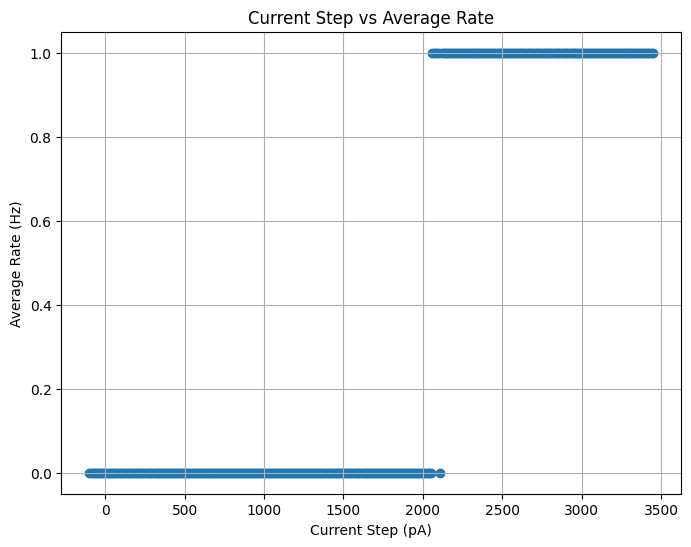

In [10]:
# Set the file path
data = 'HS21/HS21_014_0000.abf'
abf = pyabf.ABF(data)

# Initialize an empty DataFrame to store the results
table = pd.DataFrame(columns=['current_step', 'avg_rate'])

# Check the number of sweeps in the ABF file
num_sweeps = abf.sweepCount
print("Number of sweeps:", num_sweeps)

# Loop function to analyze each voltage and current trace of the file
for sweep in range(num_sweeps):
    abf.setSweep(sweep)
    time = abf.sweepX
    voltage = abf.sweepY
    current = abf.sweepC

    currents = [] # Current value between t1 and t2 (ms) for each step
    t1 = int(400*abf.dataPointsPerMs)
    t2 = int(500*abf.dataPointsPerMs)
    current_mean = np.average(abf.sweepC[t1:t2])

    start, end = 0.025, 0.525
    sfx = SpikeFeatureExtractor(start, end, filter=None, dv_cutoff=20.0, thresh_frac=0.5, max_interval=0.01, min_peak=10)
    sfx_results = sfx.process(time, voltage, current)
    stfx = SpikeTrainFeatureExtractor(start=start, end=end)
    stfx_results = stfx.process(time, voltage, current, sfx_results)

    # Update the table with the stfx results
    table.loc[sweep, 'current_step'] = current_mean
    table.loc[sweep, 'avg_rate'] = stfx_results["avg_rate"] * (end - start)

print(table)

# Plot current_step vs avg_rate
plt.figure(figsize=(8, 6))
plt.scatter(table['current_step'], table['avg_rate'], marker='o')
plt.xlabel('Current Step (pA)')
plt.ylabel('Average Rate (Hz)')
plt.title('Current Step vs Average Rate')
plt.grid(True)
plt.show()

In [12]:
# Assuming all_avg_rate_data is already defined and contains the columns with ABF filenames

# Extract the column name
column_name = 'HS21_014_0000.abf'

# Replace the data in the column with the new data from the table DataFrame
all_avg_rate_data[column_name] = table['avg_rate']

print(all_avg_rate_data)

     HS21_009_0000.abf  HS21_010_0000.abf  HS21_011_0000.abf  \
0                  0.0                0.0                0.0   
1                  0.0                0.0                0.0   
2                  0.0                0.0                0.0   
3                  0.0                0.0                0.0   
4                  0.0                0.0                0.0   
..                 ...                ...                ...   
395                NaN                NaN                NaN   
396                NaN                NaN                NaN   
397                NaN                NaN                NaN   
398                NaN                NaN                NaN   
399                NaN                NaN                NaN   

     HS21_012_0000.abf  HS21_013_0000.abf HS21_014_0000.abf  \
0                  0.0                0.0               0.0   
1                  0.0                0.0               0.0   
2                  0.0                0.0 

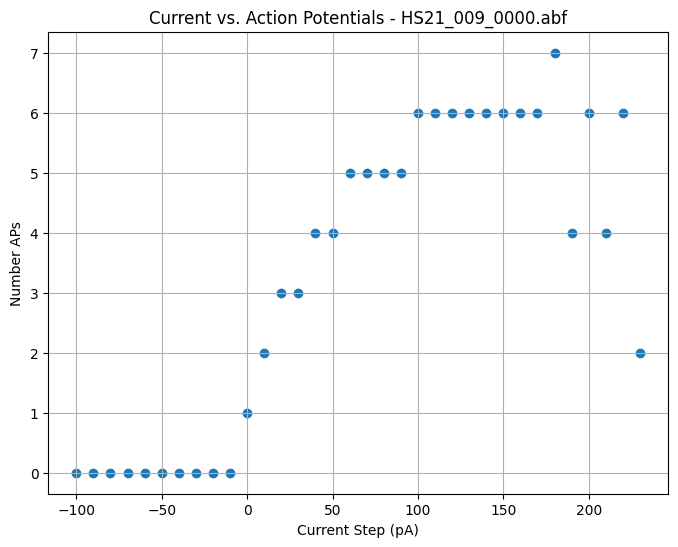

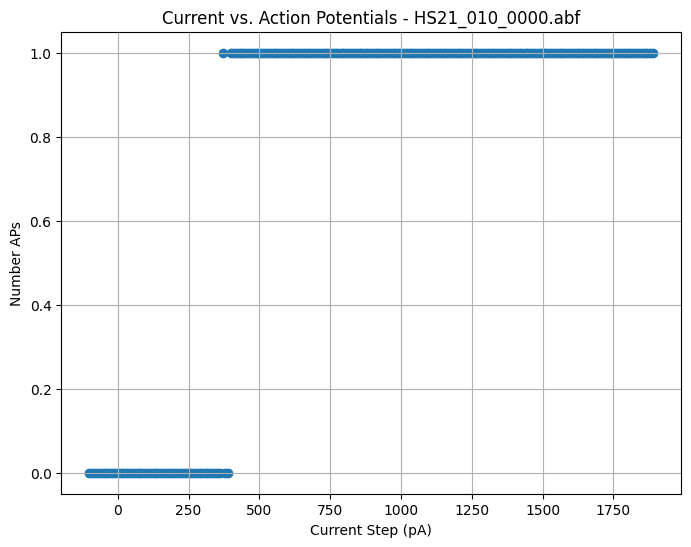

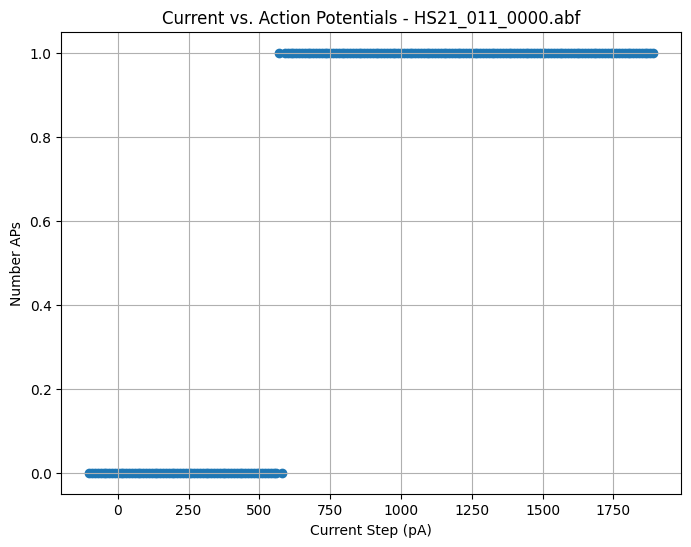

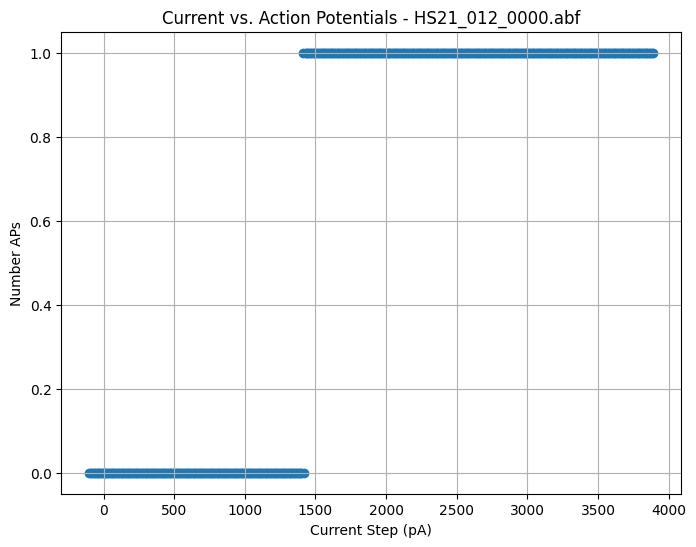

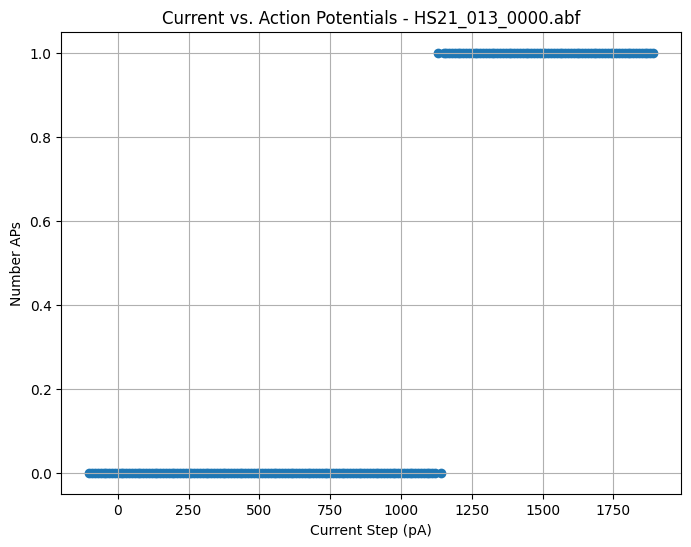

...

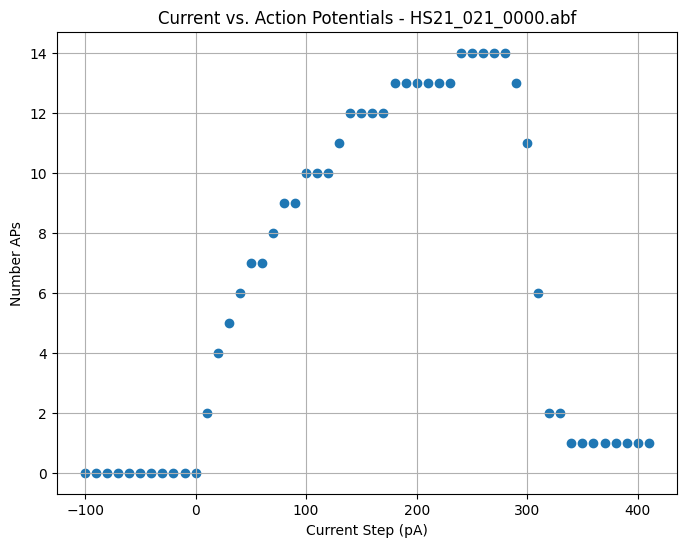

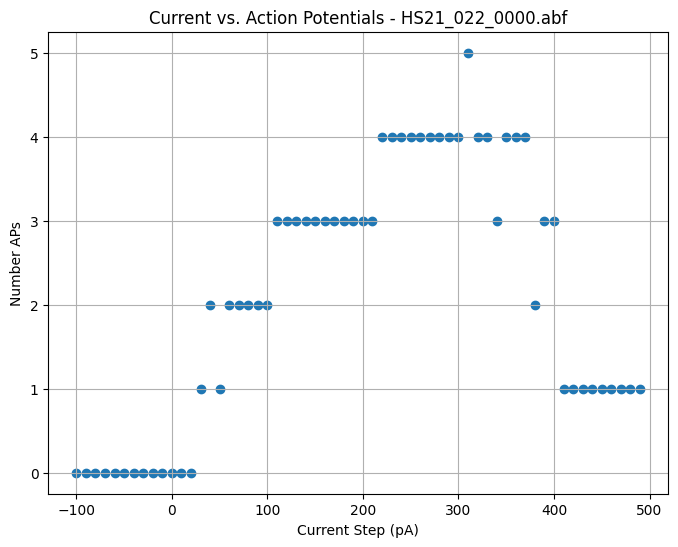

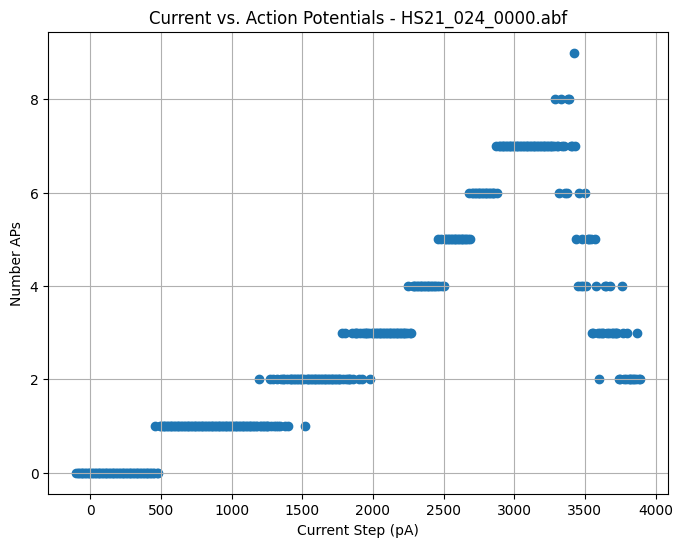

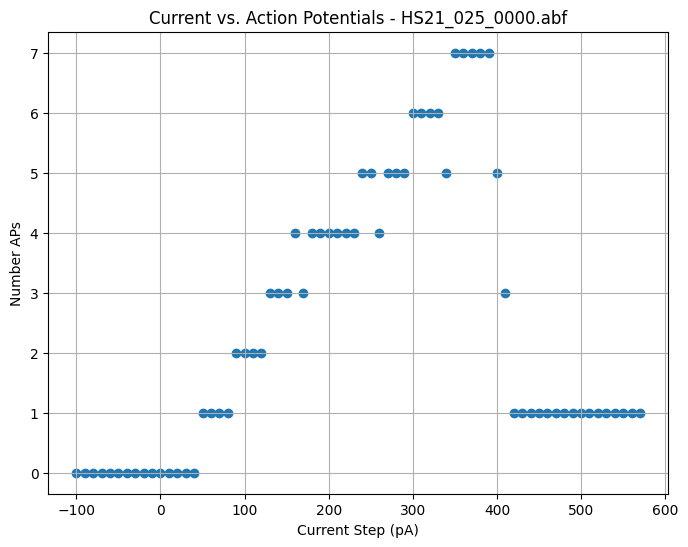

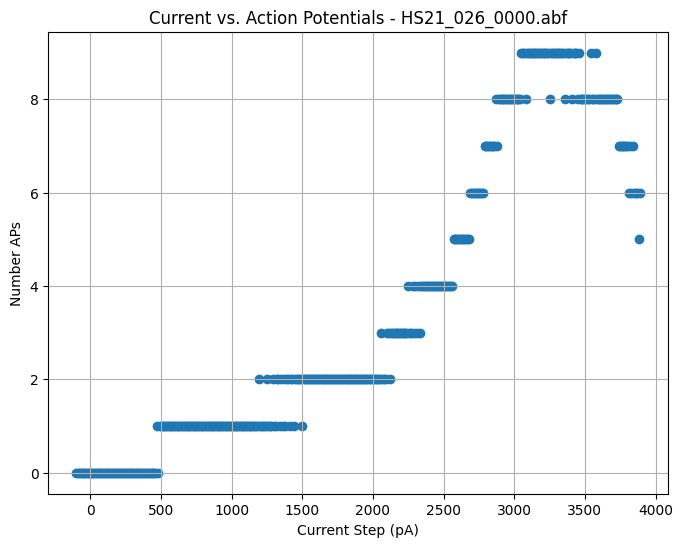

In [76]:
# Plot current vs. average rate for each file
for column in all_avg_rate_data.columns:
    plt.figure(figsize=(8, 6))
    # Generate current step values starting from -100pA increasing by 10 for each step
    current_steps = np.arange(-100, -100 + 10 * len(all_avg_rate_data), 10)
    plt.scatter(current_steps, all_avg_rate_data[column], label=column)
    plt.xlabel('Current Step (pA)')
    plt.ylabel('Number APs')
    plt.title(f'Current vs. Action Potentials - {column}')
    plt.grid(True)
    plt.show()

Now that we have extracted all the AP number at each current step for each file we can save the new CSV file

In [78]:
file_name = "HS21_APs.csv"
all_avg_rate_data.to_csv(file_name, index=False)

In [14]:
# Function to remove leading zeros and NaN values
def remove_leading_zeros(column):
    # Find the first non-zero and non-NaN value index
    first_non_zero_index = next((i for i, x in enumerate(column) if not np.isnan(x) and x != 0), None)
    if first_non_zero_index is None:
        return pd.Series(dtype=float)  # Return an empty series if all values are NaN or zero
    else:
        return column[first_non_zero_index:].reset_index(drop=True)

# Apply the function to each column
all_avg_rate_data = all_avg_rate_data.apply(remove_leading_zeros)

# Display the modified DataFrame
print(all_avg_rate_data)

     HS21_009_0000.abf  HS21_010_0000.abf  HS21_011_0000.abf  \
0                  1.0                1.0                1.0   
1                  2.0                0.0                0.0   
2                  3.0                0.0                1.0   
3                  3.0                1.0                1.0   
4                  4.0                1.0                1.0   
..                 ...                ...                ...   
385                NaN                NaN                NaN   
386                NaN                NaN                NaN   
387                NaN                NaN                NaN   
388                NaN                NaN                NaN   
389                NaN                NaN                NaN   

     HS21_012_0000.abf  HS21_013_0000.abf HS21_014_0000.abf  \
0                  1.0                1.0               1.0   
1                  0.0                0.0               1.0   
2                  1.0                1.0 

In [15]:
file_name = "HS21_f-I.csv"
all_avg_rate_data.to_csv(file_name, index=False)

Now make Current v Action Potential plot. In this case I had 2 treatment groups so I split the ABF filenames into each group, calculated the SEM of each group and plotted the f-I. 

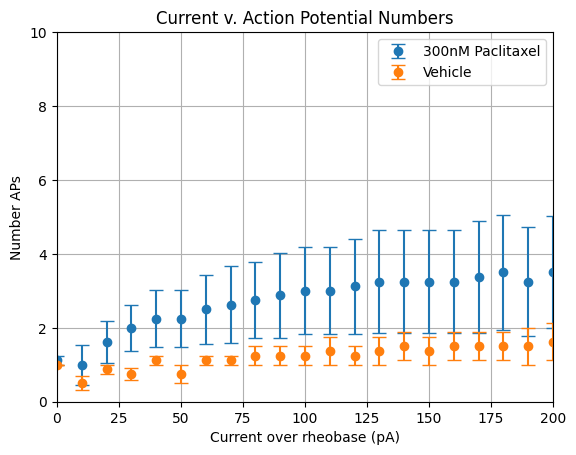

In [27]:
# Split the DataFrame into two groups based on filename
group1_filenames = ['HS21_009_0000.abf',
'HS21_010_0000.abf',
'HS21_011_0000.abf',
'HS21_012_0000.abf',
'HS21_013_0000.abf',
'HS21_017_0000.abf',
'HS21_021_0000.abf',
'HS21_022_0000.abf',
]  # List of filenames for group 1
group2_filenames = ['HS21_014_0000.abf',
'HS21_015_0000.abf',
'HS21_016_0000.abf',
'HS21_018_0000.abf',
'HS21_019_0000.abf',
'HS21_024_0000.abf',
'HS21_025_0000.abf',
'HS21_026_0000.abf',
]  # List of filenames for group 2

group1_data = all_avg_rate_data[group1_filenames]
group2_data = all_avg_rate_data[group2_filenames]

# Compute the mean along the index axis for each group
group1_mean_values = group1_data.mean(axis=1)
group2_mean_values = group2_data.mean(axis=1)

# Calculate the standard error of the mean (SEM) for each group
group1_sem_values = group1_data.sem(axis=1)
group2_sem_values = group2_data.sem(axis=1)

# Generate x-axis values starting at zero and increasing by 10
x_values = np.arange(0, len(group1_mean_values) * 10, 10)

# Plot group 1
plt.errorbar(x_values, group1_mean_values, yerr=group1_sem_values, fmt='o', capsize=5, label='300nM Paclitaxel')

# Plot group 2
plt.errorbar(x_values, group2_mean_values, yerr=group2_sem_values, fmt='o', capsize=5, label='Vehicle')

plt.xlabel('Current over rheobase (pA)')
plt.ylabel('Number APs')
plt.title('Current v. Action Potential Numbers')

# Set axis limits
plt.xlim(0, 200)
plt.ylim(0,10)

plt.legend()
plt.grid(True)
plt.show()

Filter for only the multi-firing cells. 

In [29]:
# Filter columns in group1 with values greater than 1 at some point
group1_filtered = group1_data.loc[:, (group1_data > 1).any()]

# Filter columns in group2 with values greater than 1 at some point
group2_filtered = group2_data.loc[:, (group2_data > 1).any()]

# Display the filtered DataFrames
print("Group 1 (Filtered):")
print(group1_filtered)
print("\nGroup 2 (Filtered):")
print(group2_filtered)


Group 1 (Filtered):
     HS21_009_0000.abf  HS21_017_0000.abf  HS21_021_0000.abf  \
0                  1.0                1.0                2.0   
1                  2.0                0.0                4.0   
2                  3.0                1.0                5.0   
3                  3.0                1.0                6.0   
4                  4.0                1.0                7.0   
..                 ...                ...                ...   
385                NaN                NaN                NaN   
386                NaN                NaN                NaN   
387                NaN                NaN                NaN   
388                NaN                NaN                NaN   
389                NaN                NaN                NaN   

     HS21_022_0000.abf  
0                  1.0  
1                  2.0  
2                  1.0  
3                  2.0  
4                  2.0  
..                 ...  
385                NaN  
386        

In [40]:
file_name = "HS21_f-I_multi.csv"
all_avg_rate_data.to_csv(file_name, index=False)

Make f-I plot for only the multi-firing cells

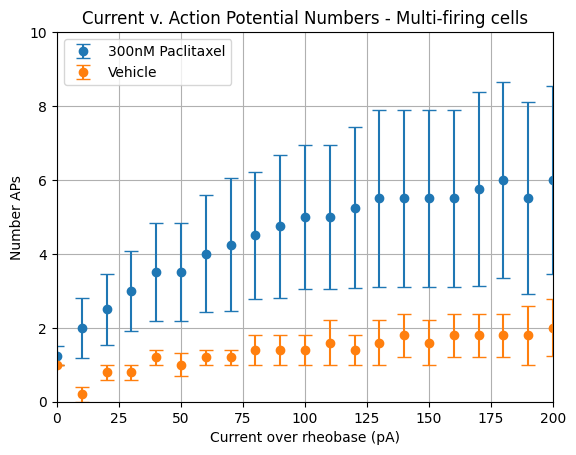

In [38]:
# Compute the mean along the index axis for each group
group1_mean_values = group1_filtered.mean(axis=1)
group2_mean_values = group2_filtered.mean(axis=1)

# Calculate the standard error of the mean (SEM) for each group
group1_sem_values = group1_filtered.sem(axis=1)
group2_sem_values = group2_filtered.sem(axis=1)

# Generate x-axis values starting at zero and increasing by 10
x_values = np.arange(0, len(group1_mean_values) * 10, 10)

# Plot group 1
plt.errorbar(x_values, group1_mean_values, yerr=group1_sem_values, fmt='o', capsize=5, label='300nM Paclitaxel')

# Plot group 2
plt.errorbar(x_values, group2_mean_values, yerr=group2_sem_values, fmt='o', capsize=5, label='Vehicle')

plt.xlabel('Current over rheobase (pA)')
plt.ylabel('Number APs')
plt.title('Current v. Action Potential Numbers - Multi-firing cells')

# Set axis limits
plt.xlim(0, 200)
plt.ylim(0,10)

plt.legend()
plt.grid(True)

plt.show()